# Find label errors in ImageNet train set using confident learning

### Note this code assumes that you've already computed psx -- the predicted probabilities for all examples in the training set using four-fold cross-validation. If you have no done that you will need to use `imagenet_train_crossval.py` to do this!


In [3]:
# These imports enhance Python2/3 compatibility.
from __future__ import print_function, absolute_import, division, unicode_literals, with_statement

In [4]:
import numpy as np
from torchvision import datasets
from sklearn.metrics import accuracy_score
import cleanlab
from cleanlab import baseline_methods
from IPython.display import Image, display
import json
import sys

In [5]:
# urllib2 for python2 and python3
try:
    # For Python 3.0 and later
    from urllib.request import urlopen
except ImportError:
    # Fall back to Python 2's urllib2
    from urllib2 import urlopen
    
# simple label names for ImageNet
url = 'https://raw.githubusercontent.com/anishathalye/imagenet-simple-labels/master/imagenet-simple-labels.json'
f = urlopen(url)
simple_labels = json.loads('\n'.join(i.decode('ascii') for i in f.readlines()))

In [6]:
# Load psx, labels, and image locations
data_dir = "/datasets/datasets/imagenet/"
traindir = data_dir + "train/"
psx = np.load(data_dir + "imagenet__train__model_resnet50__pyx.npy")
imgs, labels = [list(z) for  z in zip(*datasets.ImageFolder(traindir).imgs)]
labels = np.array(labels, dtype=int)
print('Overall accuracy: {:.2%}'.format(accuracy_score(labels, psx.argmax(axis = 1))))

Overall accuracy: 68.31%


In [8]:
# This takes ~3 minutes on a 20-thread processor for ImageNet train set.
already_computed = False
if already_computed:
    label_errors_bool = ~np.load("/home/cgn/masks/imagenet_train_bool_mask.npy")
else:
    label_errors_bool = cleanlab.pruning.get_noise_indices(
        s = labels,
        psx = psx,
        prune_method = 'prune_by_noise_rate',
        sorted_index_method=None,
    )
#     np.save("imagenet_train_bool_mask.npy", ~label_errors_bool) # Store false for errors

100%|██████████| 1000/1000 [03:02<00:00,  4.89it/s]


In [9]:
label_errors_idx = cleanlab.pruning.order_label_errors(
    label_errors_bool = label_errors_bool,
    psx = psx,
    labels = labels,
    sorted_index_method = 'normalized_margin',
)

In [10]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
import matplotlib
import torchvision.transforms as transforms
import matplotlib.image as mpimg

In [11]:
def show(img, savefig=False):
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)), interpolation='nearest')
    plt.axis('off')
    plt.gca().xaxis.set_major_locator(matplotlib.ticker.NullLocator())
    plt.gca().yaxis.set_major_locator(matplotlib.ticker.NullLocator())
    if savefig:
        plt.savefig('imagenet_figure_32.png', dpi=300, pad_inches=0.0, bbox_inches='tight')
    
def make3d(img_arr):
    img_arr = np.asarray(img_arr)
    return np.stack((img_arr,)*3, -1) if len(img_arr.shape) < 3 else img_arr

In [21]:
from PIL import Image
num2print = 8
rs = transforms.Resize((333,333))

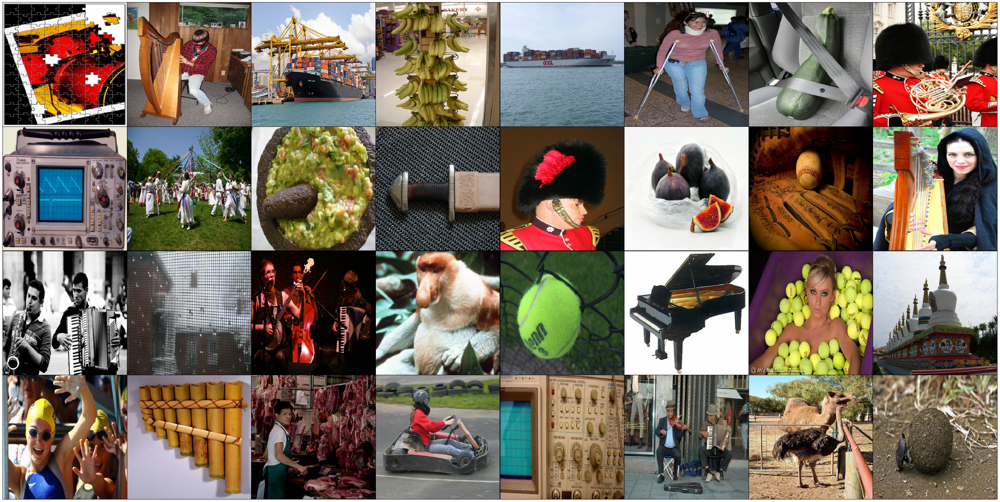

In [22]:
plt.figure(figsize=(50,40))
imglist = [transforms.ToTensor()(make3d(rs(Image.open(fn)))) for fn in fns[:32]]
show(make_grid(imglist, padding=1, normalize=True), savefig=True)

In [27]:
def padtext(s, l = 27): # 27 works well
    return s + " " * (l - len(s))
rows2print = 4
for i in range(rows2print):
    for z in given[num2print * i :num2print * i + num2print]:
        item = " Given: " + z.upper()
        print(padtext(item), end = "")
    print()
    for z in pred[num2print * i :num2print * i + num2print]:
        item = " Given: " + z.upper()
        print(padtext(item), end = "")
    print()
    for fn in fns[num2print * i:num2print * i + num2print]:
        item = " " + fn.split("/")[-1]
        print(padtext(item), end = "")
    print()

 Given: DRUM                Given: SKI MASK            Given: DOCK                Given: GROCERY STORE       Given: OCEAN LINER         Given: NECK BRACE          Given: ZUCCHINI            Given: FRENCH HORN        
 Given: JIGSAW PUZZLE       Given: HARP                Given: CONTAINER SHIP      Given: BANANA              Given: CONTAINER SHIP      Given: CRUTCH              Given: SEAT BELT           Given: MILITARY CAP       
 n03249569_20304.JPEG       n04229816_2795.JPEG        n03216828_29894.JPEG       n03461385_47146.JPEG       n03673027_11949.JPEG       n03814639_5972.JPEG        n07716358_19055.JPEG       n03394916_35439.JPEG      
 Given: CRT SCREEN          Given: POLE                Given: MORTAR              Given: SCABBARD            Given: MILITARY UNIFORM    Given: PLASTIC BAG         Given: BASEBALL PLAYER     Given: CLOAK              
 Given: OSCILLOSCOPE        Given: MAYPOLE             Given: GUACAMOLE           Given: CHAIN MAIL          Given: MILITARY CAP    

In [ ]:
def padtext(s, l = 27): # 27 works well
    return s + " " * (l - len(s))
rows2print = 4
for i in range(rows2print):
    for z in given[num2print * i :num2print * i + num2print]:
        item = " Given: " + z.upper()
        print(padtext(item), end = "")
    print()
    for z in pred[num2print * i :num2print * i + num2print]:
        item = " Given: " + z.upper()
        print(padtext(item), end = "")
    print()
    for fn in fns[num2print * i:num2print * i + num2print]:
        item = " " + fn.split("/")[-1]
        print(padtext(item), end = "")
    print()

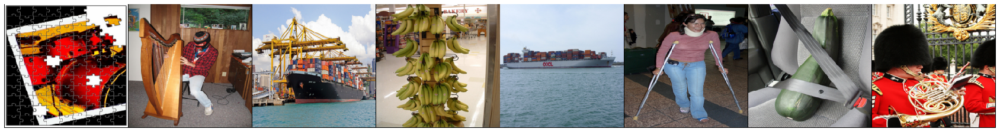

 GIVEN: drum                GIVEN: ski mask            GIVEN: dock                GIVEN: grocery store       GIVEN: ocean liner         GIVEN: neck brace          GIVEN: zucchini            GIVEN: French horn        
 GUESS: jigsaw puzzle       GUESS: harp                GUESS: container ship      GUESS: banana              GUESS: container ship      GUESS: crutch              GUESS: seat belt           GUESS: military cap       
 n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG      

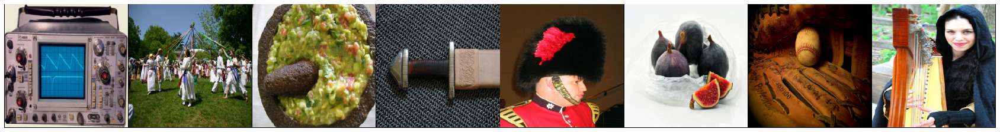

 GIVEN: CRT screen          GIVEN: pole                GIVEN: mortar              GIVEN: scabbard            GIVEN: military uniform    GIVEN: plastic bag         GIVEN: baseball player     GIVEN: cloak              
 GUESS: oscilloscope        GUESS: maypole             GUESS: guacamole           GUESS: chain mail          GUESS: military cap        GUESS: fig                 GUESS: baseball            GUESS: harp               
 n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG      

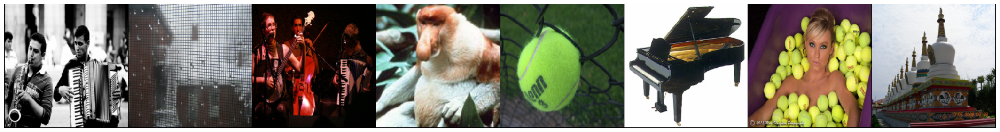

 GIVEN: saxophone           GIVEN: fire screen sheet   GIVEN: banjo               GIVEN: patas monkey        GIVEN: chain-link fence    GIVEN: upright piano       GIVEN: tub                 GIVEN: monastery          
 GUESS: accordion           GUESS: window screen       GUESS: accordion           GUESS: proboscis monkey    GUESS: tennis ball         GUESS: grand piano         GUESS: tennis ball         GUESS: stupa              
 n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG      

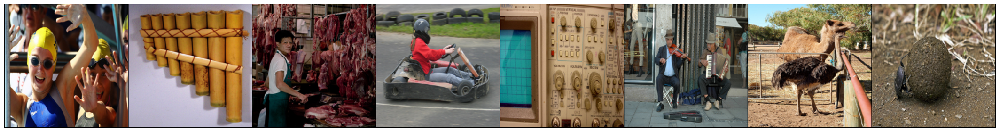

 GIVEN: sunglass            GIVEN: flute               GIVEN: grocery store       GIVEN: crash helmet        GIVEN: CRT screen          GIVEN: violin              GIVEN: dromedary           GIVEN: ground beetle      
 GUESS: swimming cap        GUESS: pan flute           GUESS: butcher shop        GUESS: go-kart             GUESS: oscilloscope        GUESS: accordion           GUESS: ostrich             GUESS: dung beetle        
 n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG       n03976657_22445.JPEG      

In [186]:
rows2print = 4
for i in range(rows2print):
    plt.figure(figsize=(30,10))
    imglist = [transforms.ToTensor()(make3d(rs(Image.open(fn)))) for fn in fns[
        num2print * i :num2print * i + num2print]]
    show(make_grid(imglist, padding=1, normalize=True))
    plt.show()
    for z in given[num2print * i :num2print * i + num2print]:
        item = " GIVEN: " + z
        print(padtext(item), end = "")
    print()
    for z in guess[num2print * i :num2print * i + num2print]:
        item = " GUESS: " + z
        print(padtext(item), end = "")
    print()
    for z in fns[num2print * i:num2print * i + num2print]:
        item = " " + fn.split("/")[-1]
        print(padtext(item), end = "")

Given: DRUM
Guess: JIGSAW PUZZLE
n03249569_20304.JPEG


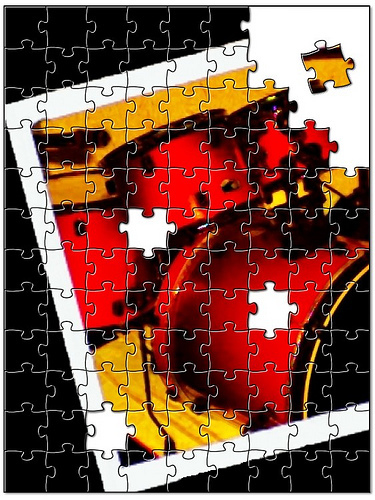



Given: SKI MASK
Guess: HARP
n04229816_2795.JPEG


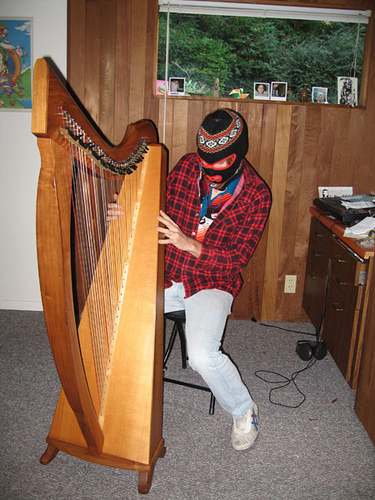



Given: DOCK
Guess: CONTAINER SHIP
n03216828_29894.JPEG


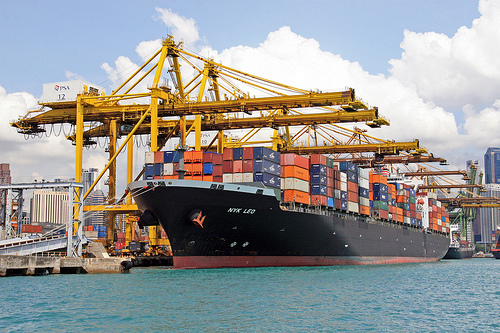



Given: GROCERY STORE
Guess: BANANA
n03461385_47146.JPEG


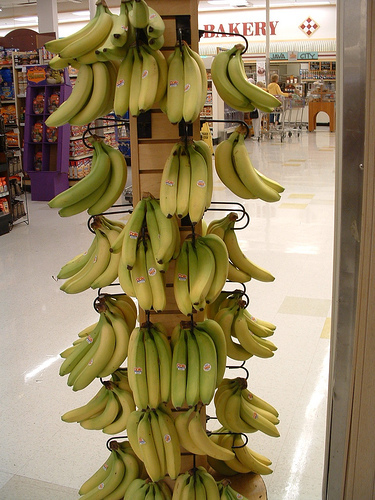



Given: OCEAN LINER
Guess: CONTAINER SHIP
n03673027_11949.JPEG


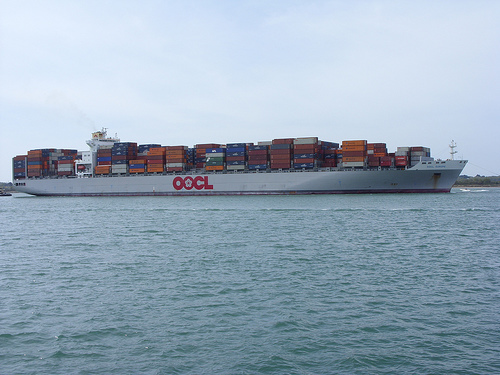



Given: NECK BRACE
Guess: CRUTCH
n03814639_5972.JPEG


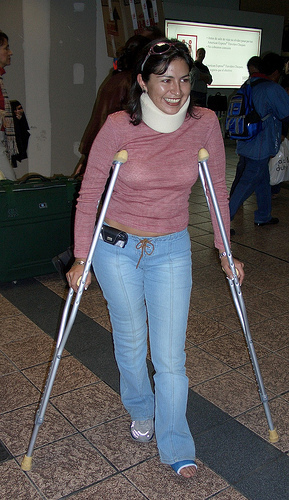



Given: ZUCCHINI
Guess: SEAT BELT
n07716358_19055.JPEG


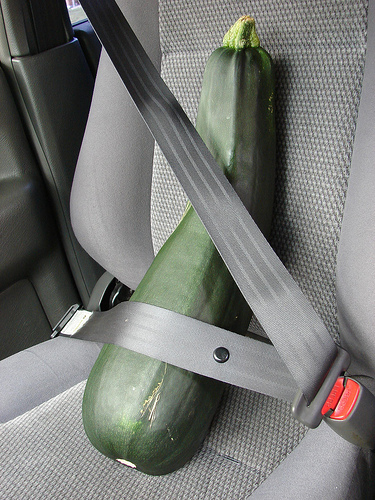



Given: FRENCH HORN
Guess: MILITARY CAP
n03394916_35439.JPEG


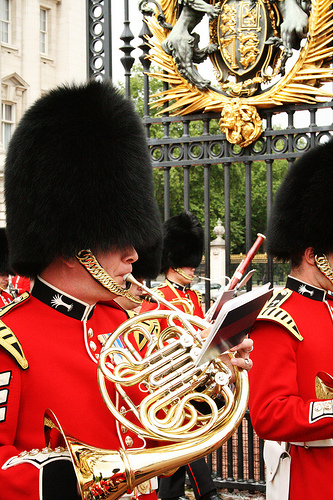



Given: CRT SCREEN
Guess: OSCILLOSCOPE
n04152593_3203.JPEG


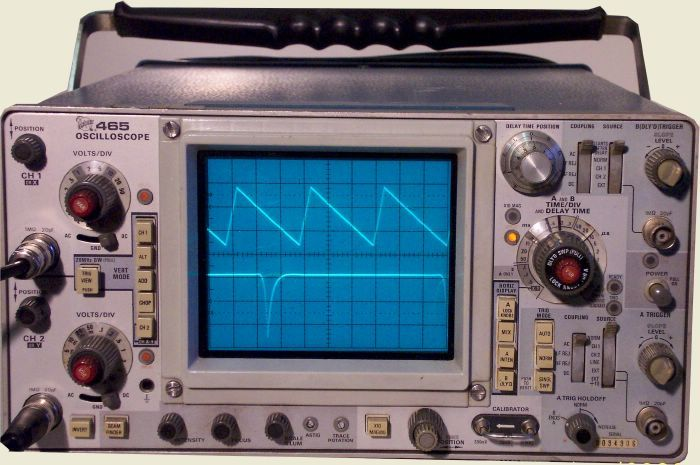



Given: POLE
Guess: MAYPOLE
n03976657_22445.JPEG


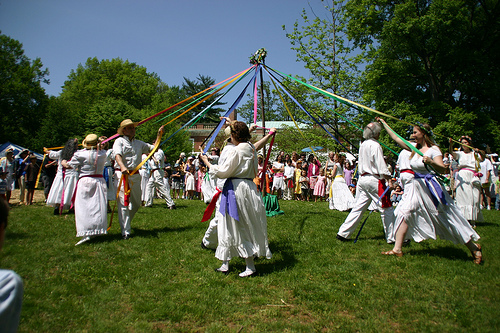



Given: MORTAR
Guess: GUACAMOLE
n03786901_10564.JPEG


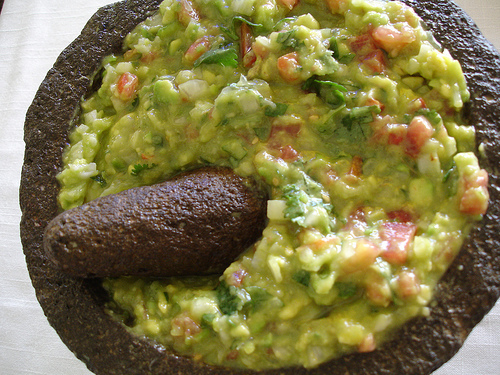



Given: SCABBARD
Guess: CHAIN MAIL
n04141327_7141.JPEG


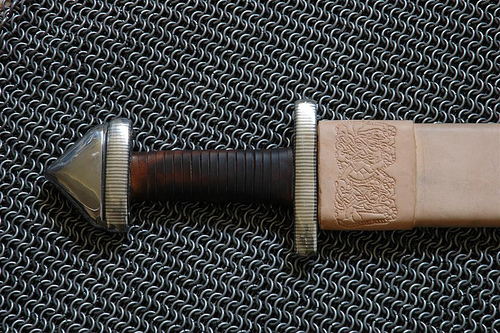



Given: MILITARY UNIFORM
Guess: MILITARY CAP
n03763968_6076.JPEG


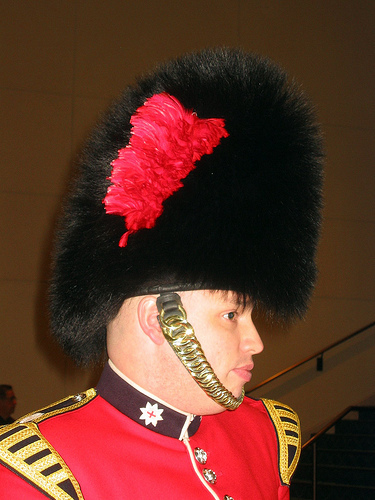



Given: PLASTIC BAG
Guess: FIG
n03958227_10829.JPEG


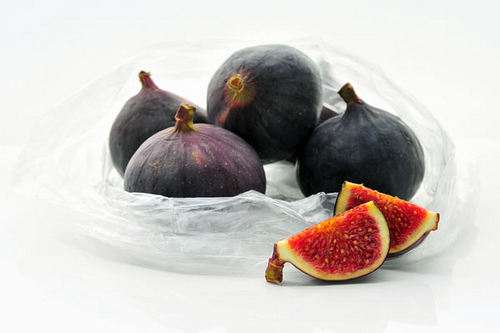



Given: BASEBALL PLAYER
Guess: BASEBALL
n09835506_7768.JPEG


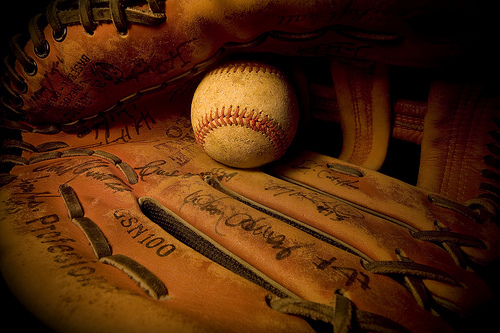



Given: CLOAK
Guess: HARP
n03045698_6969.JPEG


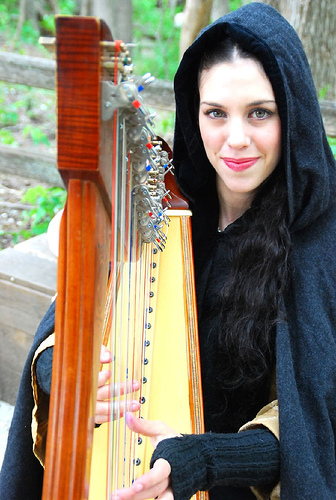



Given: SAXOPHONE
Guess: ACCORDION
n04141076_38417.JPEG


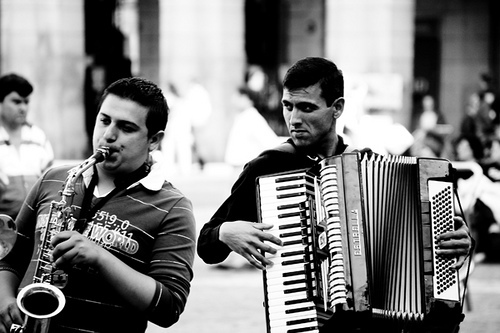



Given: FIRE SCREEN SHEET
Guess: WINDOW SCREEN
n03347037_4434.JPEG


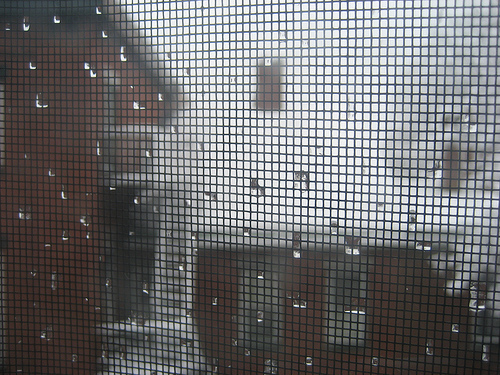



Given: BANJO
Guess: ACCORDION
n02787622_426.JPEG


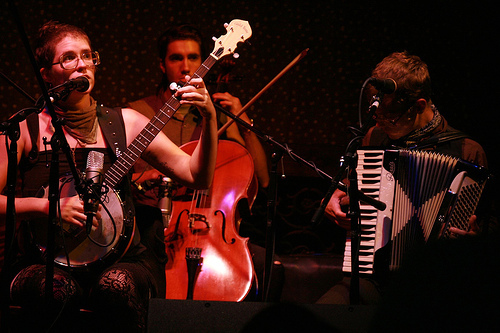



Given: PATAS MONKEY
Guess: PROBOSCIS MONKEY
n02486261_2877.JPEG


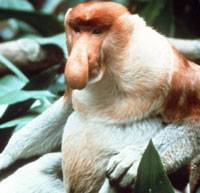



Given: CHAIN-LINK FENCE
Guess: TENNIS BALL
n03000134_3569.JPEG


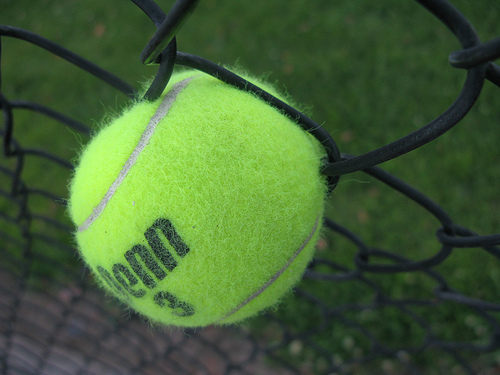



Given: UPRIGHT PIANO
Guess: GRAND PIANO
n04515003_1567.JPEG


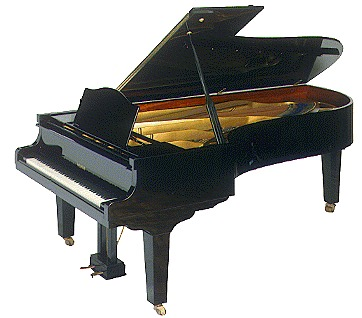



Given: TUB
Guess: TENNIS BALL
n04493381_38585.JPEG


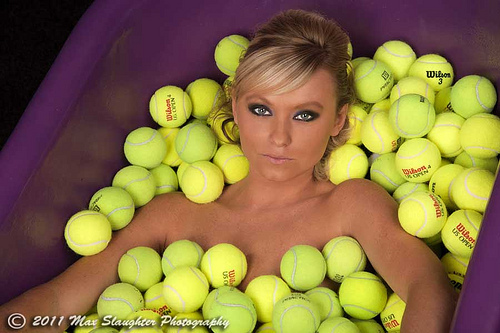



Given: MONASTERY
Guess: STUPA
n03781244_17833.JPEG


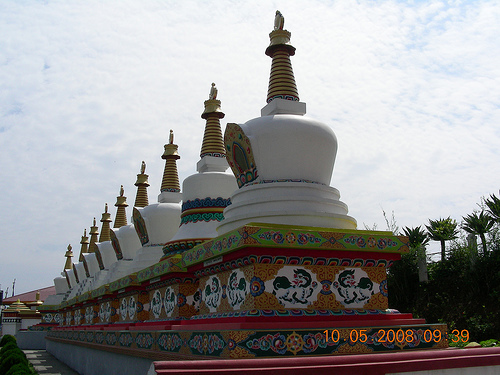



Given: SUNGLASS
Guess: SWIMMING CAP
n04355933_1885.JPEG


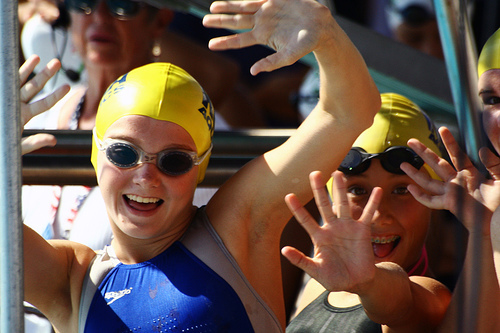



Given: FLUTE
Guess: PAN FLUTE
n03372029_12170.JPEG


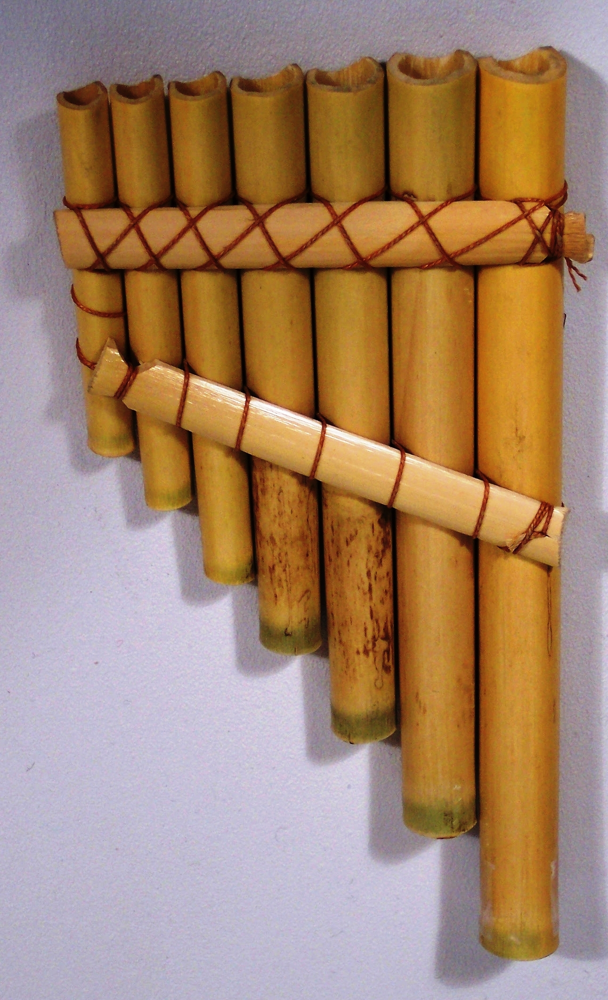



Given: GROCERY STORE
Guess: BUTCHER SHOP
n03461385_51467.JPEG


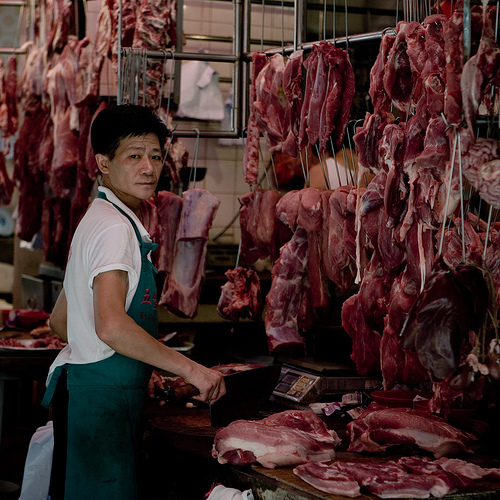



Given: CRASH HELMET
Guess: GO-KART
n03127747_4353.JPEG


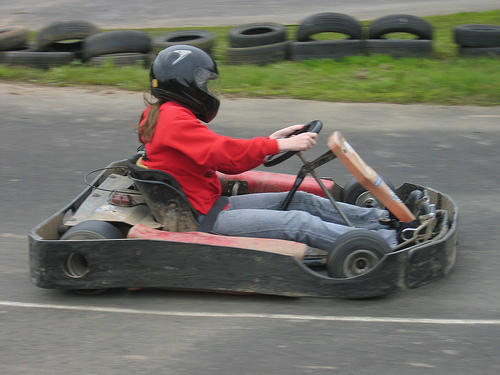



Given: CRT SCREEN
Guess: OSCILLOSCOPE
n04152593_16488.JPEG


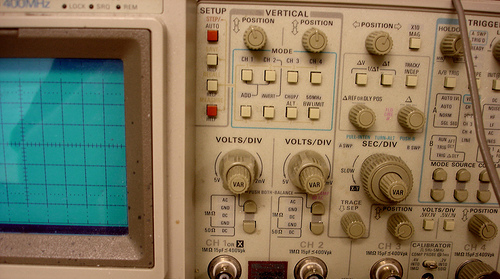



Given: VIOLIN
Guess: ACCORDION
n04536866_39332.JPEG


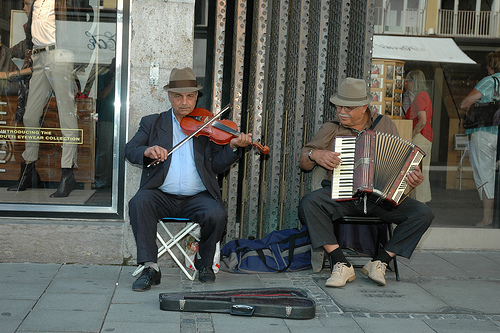



Given: DROMEDARY
Guess: OSTRICH
n02437312_8521.JPEG


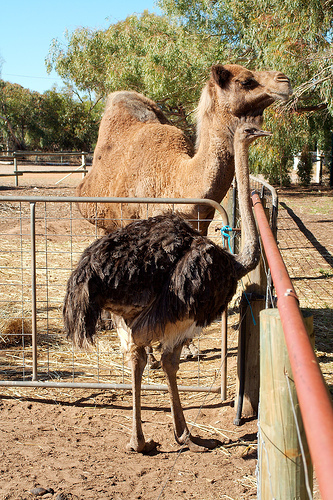



Given: GROUND BEETLE
Guess: DUNG BEETLE
n02167151_1509.JPEG


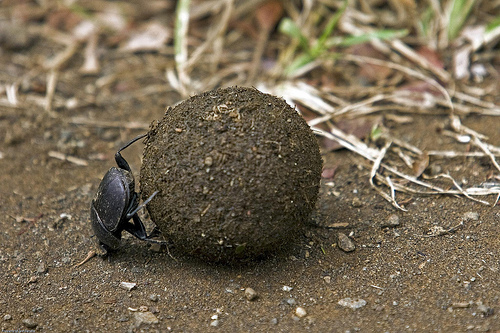



Given: SKUNK
Guess: BLACK-AND-WHITE COLOBUS
n02445715_1220.JPEG


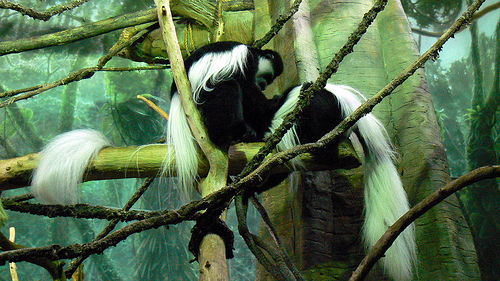



Given: BOW TIE
Guess: BILLIARD TABLE
n02883205_5696.JPEG


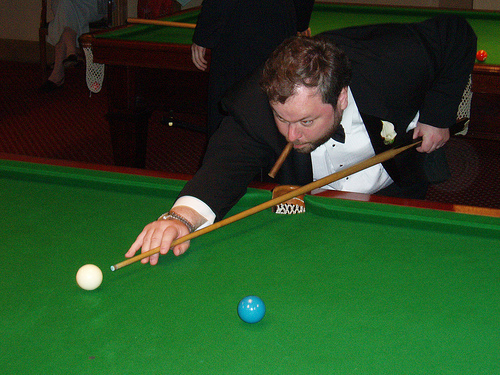



Given: GOOSE
Guess: BLACK SWAN
n01855672_11292.JPEG


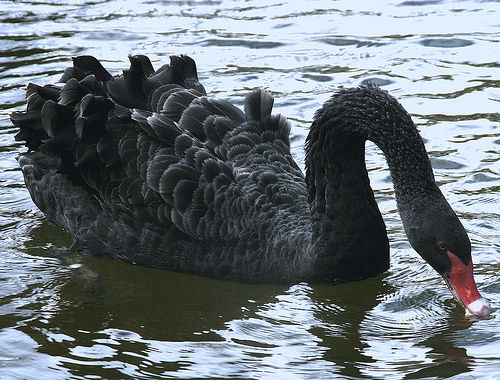



Given: RULER
Guess: SLIDE RULE
n04118776_6350.JPEG


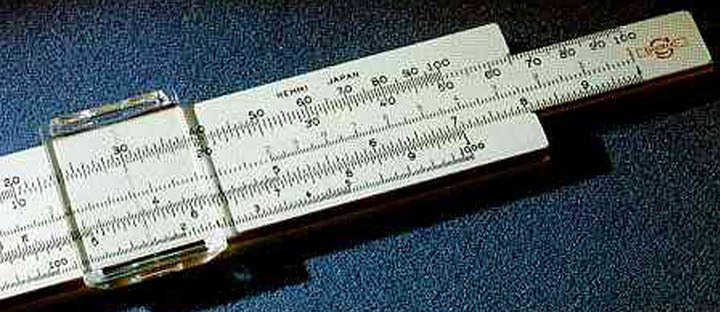



Given: SAHARAN HORNED VIPER
Guess: INDIAN COBRA
n01753488_18372.JPEG


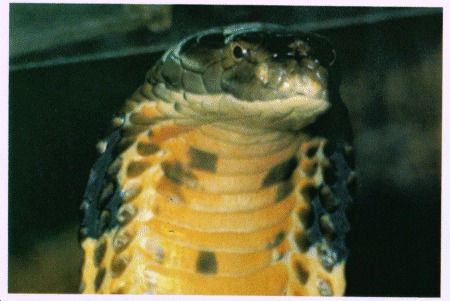



Given: DUTCH OVEN
Guess: CAULDRON
n03259280_10340.JPEG


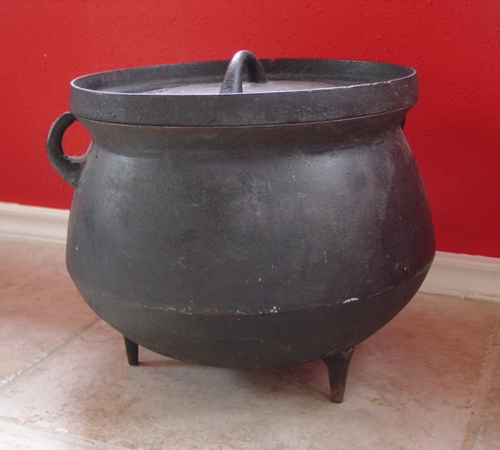



Given: COWBOY HAT
Guess: FEATHER BOA
n03124170_5082.JPEG


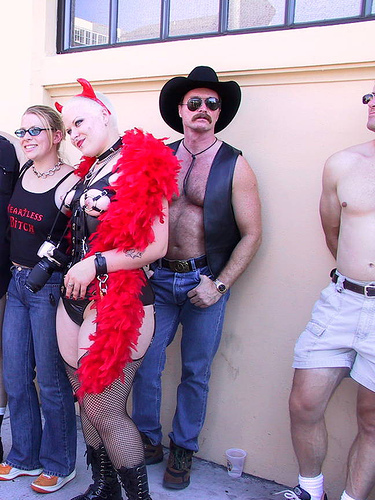



Given: MAGNETIC COMPASS
Guess: SUNDIAL
n03706229_5474.JPEG


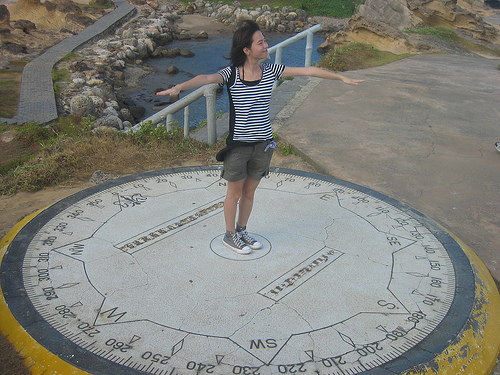

In [28]:
from IPython.display import Image, display
num2print = 40
fns = []
given = []
pred = []
for idx in label_errors_idx[:num2print]:
    fn = imgs[idx]
    fns.append(fn)
    given.append(simple_labels[labels[idx]])
    pred.append(simple_labels[np.argmax(psx[idx])])
    print("Given:", given[-1].upper()) 
    print("Guess:", pred[-1].upper())
    print(fn.split("/")[-1])
    sys.stdout.flush()
    display(Image(filename=fn))
    print("\n")

# Create multiple files storing the indices of errors for the top 20% of errors, top 40% of errors, etc.

In [60]:
# Take the opposite of the stored file (errors should be true, not false)
label_errors_bool = ~np.load("imagenet_train_bool_mask.npy")

In [61]:
label_errors_idx = cleanlab.pruning.order_label_errors(
    label_errors_bool = label_errors_bool,
    psx = psx,
    labels = labels,
    sorted_index_method = 'normalized_margin',
)

In [62]:
# Creates seperate files for the top 20% errors, 40% errors,...
for i in range(1,5):
    # Prepare arguments
    amt = str(100 * i // 5)
    end_idx = len(label_errors_idx) * i // 5
    partial_errors_idx = label_errors_idx[:end_idx]
    # Create new bool mask
    bool_mask = np.zeros(len(label_errors_bool), dtype=bool)
    bool_mask[partial_errors_idx] = True
    # Validate
    assert(all(np.array([i for i, b in enumerate(bool_mask) if b]) == sorted(partial_errors_idx)))
    print(amt, end_idx)
    np.save("imagenet_train_bool_mask__fraction_{}.npy".format(amt), ~bool_mask)
    
# Verify written files
for i in range(1, 5):
    amt = str(100 * i // 5)
    end_idx = len(label_errors_idx) * i // 5
    truth = np.array(sorted(label_errors_idx[:end_idx]))
    us = np.array([i for i, b in enumerate(~np.load("imagenet_train_bool_mask__fraction_{}.npy".format(amt))) if b])
    assert(all(truth == us))

20 35658
40 71317
60 106976
80 142635


# Create these files for various methods of finding label errors

In [5]:
# confident joint only method for getting label errors
label_error_mask = np.zeros(len(labels), dtype=bool)
label_error_indices = cleanlab.latent_estimation.compute_confident_joint(
    labels, psx, return_indices_of_off_diagonals=True
)[1]
for idx in label_error_indices:
    label_error_mask[idx] = True
label_errors_bool_cj_only = label_error_mask

label_errors_bool_both = cleanlab.pruning.get_noise_indices(
    s = labels,
    psx = psx,
    prune_method = 'both',
    sorted_index_method=None,
)

label_errors_bool_pbc = cleanlab.pruning.get_noise_indices(
    s = labels,
    psx = psx,
    prune_method = 'prune_by_class',
    sorted_index_method=None,
)

label_errors_bool_pbnr = cleanlab.pruning.get_noise_indices(
    s = labels,
    psx = psx,
    prune_method = 'prune_by_noise_rate',
    sorted_index_method=None,
)

label_errors_bool_argmax = baseline_methods.baseline_argmax(psx, labels)

100%|██████████| 1000/1000 [02:56<00:00,  3.28it/s]


In [7]:
le_idx_both = cleanlab.pruning.order_label_errors(label_errors_bool_both, psx, labels)
le_idx_pbc = cleanlab.pruning.order_label_errors(label_errors_bool_pbc, psx, labels)
le_idx_pbnr = cleanlab.pruning.order_label_errors(label_errors_bool_pbnr, psx, labels)
le_idx_argmax = cleanlab.pruning.order_label_errors(label_errors_bool_argmax, psx, labels)
le_idx_cj_only = cleanlab.pruning.order_label_errors(label_errors_bool_cj_only, psx, labels)

In [9]:
for key, label_errors_idx in {
#     'both': le_idx_both,
#     'argmax': le_idx_argmax,
#     'cj_only': le_idx_cj_only,
    'cl_pbnr': le_idx_pbnr,
    'cl_pbc': le_idx_pbc,
}.items():
    # Creates seperate files for the top 20% errors, 40% errors,...
    for i in range(1,6):
        # Prepare arguments
        amt = str(100 * i // 5)
        end_idx = len(label_errors_idx) * i // 5
        partial_errors_idx = label_errors_idx[:end_idx]
        # Create new bool mask
        bool_mask = np.zeros(len(label_errors_bool_both), dtype=bool)
        bool_mask[partial_errors_idx] = True
        # Validate
        assert(all(np.array([i for i, b in enumerate(bool_mask) if b]) == sorted(partial_errors_idx)))
        print(amt, end_idx)
        np.save("/home/cgn/masks/imagenet_train_bool_{}_mask__fraction_{}.npy".format(key, amt), ~bool_mask)

    # Verify written files
    for i in range(1, 6):
        amt = str(100 * i // 5)
        end_idx = len(label_errors_idx) * i // 5
        truth = np.array(sorted(label_errors_idx[:end_idx]))
        us = np.array([i for i, b in enumerate(~np.load("/home/cgn/masks/imagenet_train_bool_{}_mask__fraction_{}.npy".format(key, amt))) if b])
        assert(all(truth == us))

20 38825
40 77650
60 116475
80 155300
100 194125
20 41765
40 83531
60 125296
80 167062
100 208828
